# Helmet mapping + DeepSORT
https://www.kaggle.com/robikscube/helper-code-helmet-mapping-deepsort

In [1]:
# # Developer

# %cd /kaggle
# from IPython.display import clear_output
# pat = input('GitHub Personal Access Token:')
# clear_output()
# ! git clone https://$pat@github.com/qAp/nfl_helmet_assignment_kaggle.git

In [2]:
# %cd /kaggle/nfl_helmet_assignment_kaggle/
# ! git pull

In [3]:
# User

! cp -r /kaggle/input/nfl-helmet-assignment-kaggle/nfl_helmet_assignment_kaggle /kaggle/.

In [4]:
import os, sys
from tqdm.auto import tqdm
import multiprocessing
import random
import numpy as np
import pandas as pd
import cv2
import matplotlib
import matplotlib.pyplot as plt
from IPython.display import Video, display

sys.path.append('/kaggle/input/easydict-master/easydict-master')
sys.path.append(
    ('/kaggle/input/yolov5-deepsort-pytorch/Yolov5_DeepSort_Pytorch-master'
     '/Yolov5_DeepSort_Pytorch-master/deep_sort_pytorch')
)
sys.path.append('/kaggle/nfl_helmet_assignment_kaggle/')

from helmet_tracker.utils.score import check_submission, NFLAssignmentScorer
from helmet_tracker.utils.features import add_track_features
from helmet_tracker.models.deepsort_postprocess import (deepsort_helmets, 
                                                        add_deepsort_label_col,
                                                        score_vs_deepsort)
from helmet_tracker.utils.video import video_with_predictions

In [5]:
# import importlib
# import helmet_tracker
# importlib.reload(helmet_tracker.models.deepsort_postprocess)

# Loading helmet mapping results

In [6]:
debug = True

BASE_DIR = '/kaggle/input/nfl-health-and-safety-helmet-assignment'

labels = pd.read_csv(f'{BASE_DIR}/train_labels.csv')

# video_dir = '/kaggle/input/nfl-health-and-safety-helmet-assignment/train'
# submission_df = pd.read_csv('/kaggle/input/nfl-mydata/submission_helmtrack_debug.csv')

video_dir = '/kaggle/input/nfl-health-and-safety-helmet-assignment/train'
submission_df = pd.read_csv('/kaggle/input/nfl-mydata/submission_helmtrack2d_debug.csv')

# video_dir = '/kaggle/input/nfl-health-and-safety-helmet-assignment/test'
# submission_df = pd.read_csv('/kaggle/input/nfl-mydata/submission_helmtrack.csv')    

# DeepSORT post-processing

In [7]:
submission_df['video'] = submission_df['video_frame'].str.split('_').str[:3].str.join('_')
submission_df['frame'] = submission_df['video_frame'].str.split('_').str[-1].astype(int)

In [8]:
%%writefile deepsort.yaml

DEEPSORT:
  REID_CKPT: '/kaggle/input/yolov5-deepsort-pytorch/ckpt.t7'
  MAX_DIST: 0.2
  MIN_CONFIDENCE: 0.3
  NMS_MAX_OVERLAP: 0.5
  MAX_IOU_DISTANCE: 0.7
  MAX_AGE: 70
  N_INIT: 3
  NN_BUDGET: 100

Writing deepsort.yaml


  0%|          | 0/6 [00:00<?, ?it/s]

==== 57700_001264_Endzone ====


  0%|          | 0/493 [00:00<?, ?it/s]

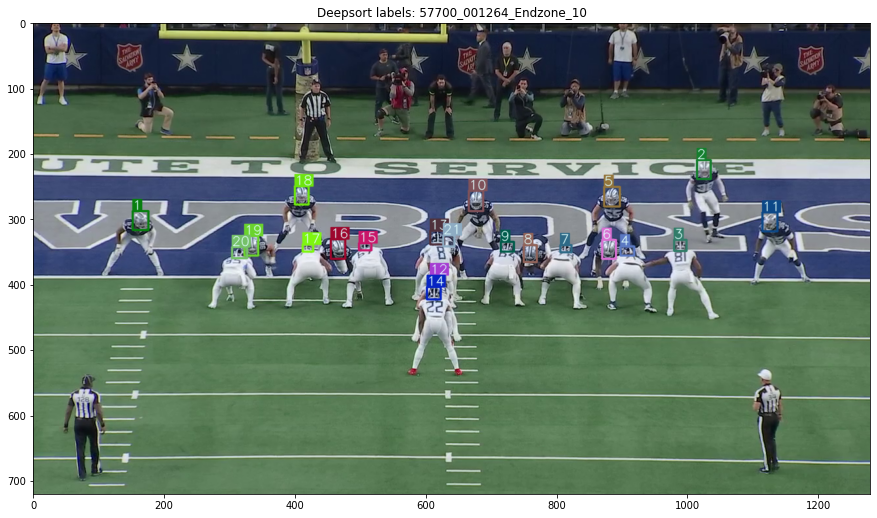

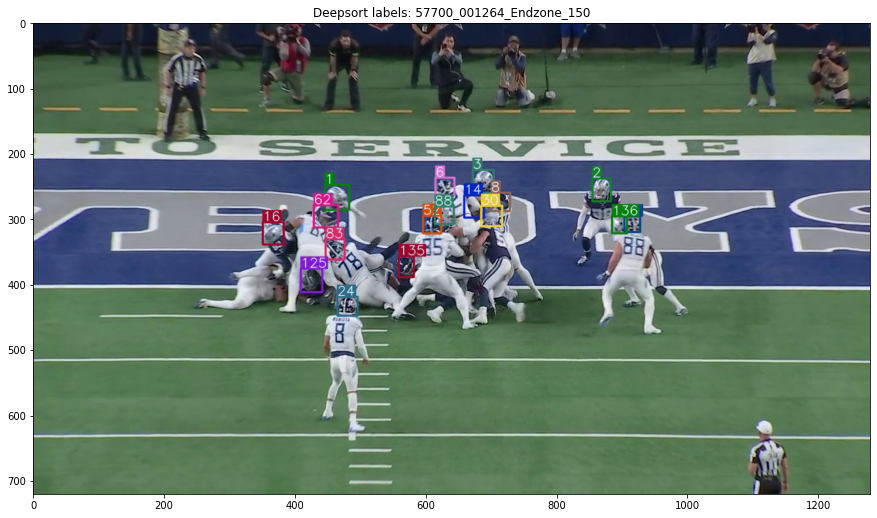

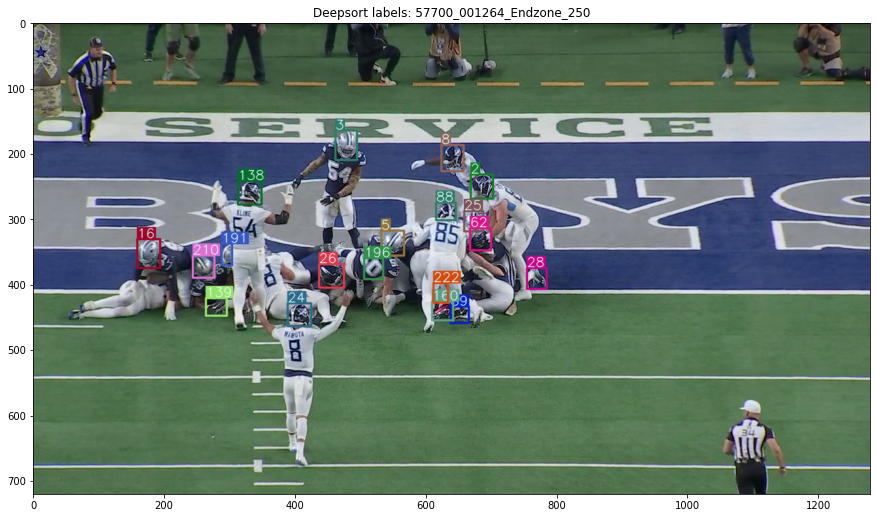

video_data:


,video_frame,left,width,top,height,label,video,frame
0,57700_001264_Endzone_1,152,24,288,29,H57,57700_001264_Endzone,1
1,57700_001264_Endzone_1,303,23,343,16,V85,57700_001264_Endzone,1
2,57700_001264_Endzone_1,325,20,328,28,H98,57700_001264_Endzone,1
3,57700_001264_Endzone_1,400,22,249,28,H50,57700_001264_Endzone,1
4,57700_001264_Endzone_1,409,18,338,13,V77,57700_001264_Endzone,1


out:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster
0,57700_001264_Endzone_1,152,24,288,29,H57,57700_001264_Endzone,1,164.0,302.0,NaN,NaN
1,57700_001264_Endzone_1,1002,20,210,29,H38,57700_001264_Endzone,1,1012.0,224.0,NaN,NaN
2,57700_001264_Endzone_1,980,20,332,17,V81,57700_001264_Endzone,1,990.0,340.0,NaN,NaN
3,57700_001264_Endzone_1,900,20,342,13,V71,57700_001264_Endzone,1,910.0,348.0,NaN,NaN
4,57700_001264_Endzone_1,874,24,244,30,H55,57700_001264_Endzone,1,886.0,259.0,NaN,NaN


out with deepsort label:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster,label_deepsort,label_count_deepsort
0,57700_001264_Endzone_1,152,24,288,29,H57,57700_001264_Endzone,1,164.0,302.0,NaN,NaN,NaN,NaN
1,57700_001264_Endzone_1,1002,20,210,29,H38,57700_001264_Endzone,1,1012.0,224.0,NaN,NaN,NaN,NaN
2,57700_001264_Endzone_1,980,20,332,17,V81,57700_001264_Endzone,1,990.0,340.0,NaN,NaN,NaN,NaN
3,57700_001264_Endzone_1,900,20,342,13,V71,57700_001264_Endzone,1,910.0,348.0,NaN,NaN,NaN,NaN
4,57700_001264_Endzone_1,874,24,244,30,H55,57700_001264_Endzone,1,886.0,259.0,NaN,NaN,NaN,NaN


(9036, 13)
(6643, 13)
0.36661 before --> 0.49578 deepsort
==== 57700_001264_Sideline ====


  0%|          | 0/493 [00:00<?, ?it/s]

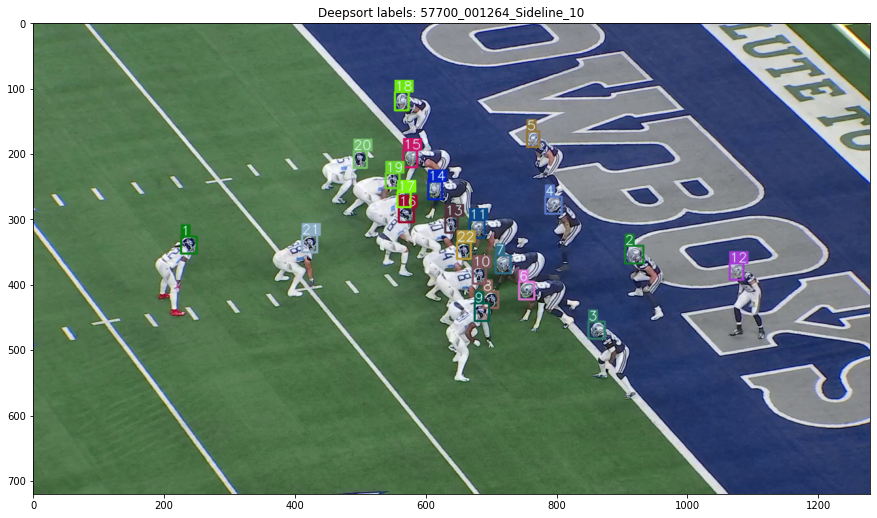

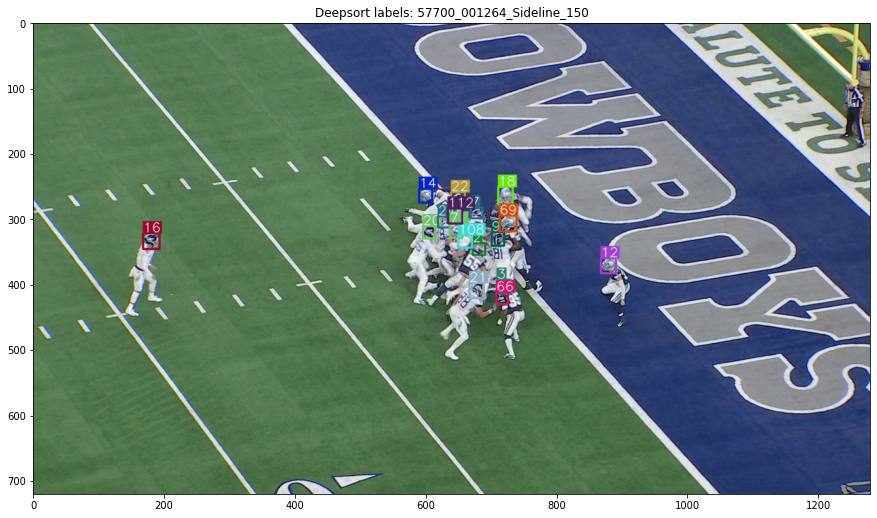

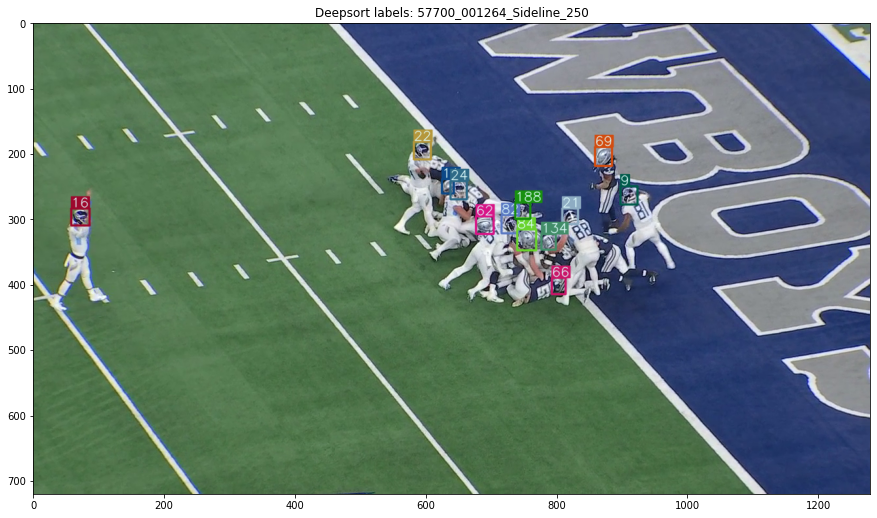

video_data:


,video_frame,left,width,top,height,label,video,frame
9036,57700_001264_Sideline_1,225,24,326,26,V22,57700_001264_Sideline,1
9037,57700_001264_Sideline_1,411,23,324,26,V88,57700_001264_Sideline,1
9038,57700_001264_Sideline_1,490,20,196,27,V85,57700_001264_Sideline,1
9039,57700_001264_Sideline_1,538,21,228,23,V77,57700_001264_Sideline,1
9040,57700_001264_Sideline_1,553,20,107,27,V8,57700_001264_Sideline,1


out:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster
0,57700_001264_Sideline_1,225,24,326,26,V22,57700_001264_Sideline,1,237.0,339.0,NaN,NaN
1,57700_001264_Sideline_1,912,24,338,22,H55,57700_001264_Sideline,1,924.0,349.0,NaN,NaN
2,57700_001264_Sideline_1,850,24,456,26,H35,57700_001264_Sideline,1,862.0,469.0,NaN,NaN
3,57700_001264_Sideline_1,788,26,256,27,H54,57700_001264_Sideline,1,801.0,270.0,NaN,NaN
4,57700_001264_Sideline_1,756,20,166,24,H50,57700_001264_Sideline,1,766.0,178.0,NaN,NaN


out with deepsort label:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster,label_deepsort,label_count_deepsort
0,57700_001264_Sideline_1,225,24,326,26,V22,57700_001264_Sideline,1,237.0,339.0,NaN,NaN,NaN,NaN
1,57700_001264_Sideline_1,912,24,338,22,H55,57700_001264_Sideline,1,924.0,349.0,NaN,NaN,NaN,NaN
2,57700_001264_Sideline_1,850,24,456,26,H35,57700_001264_Sideline,1,862.0,469.0,NaN,NaN,NaN,NaN
3,57700_001264_Sideline_1,788,26,256,27,H54,57700_001264_Sideline,1,801.0,270.0,NaN,NaN,NaN,NaN
4,57700_001264_Sideline_1,756,20,166,24,H50,57700_001264_Sideline,1,766.0,178.0,NaN,NaN,NaN,NaN


(8990, 13)
(7086, 13)
0.27054 before --> 0.41782 deepsort
==== 57783_003374_Endzone ====


  0%|          | 0/451 [00:00<?, ?it/s]

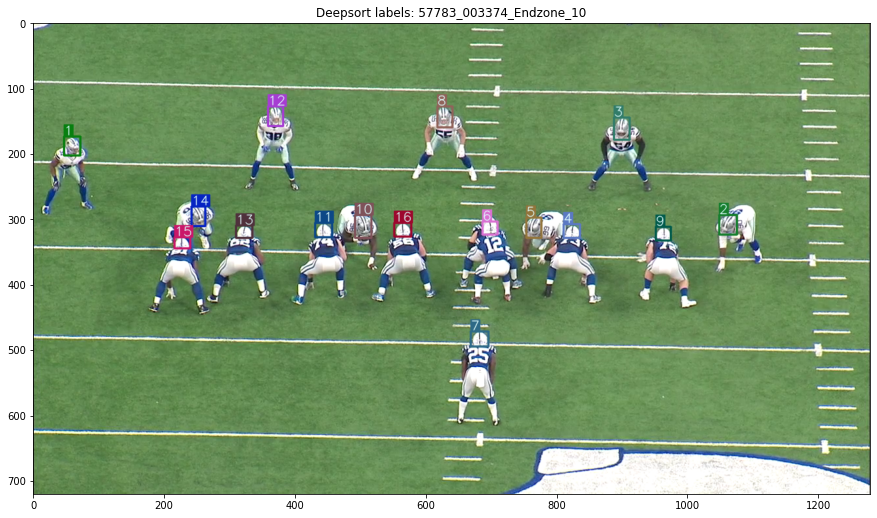

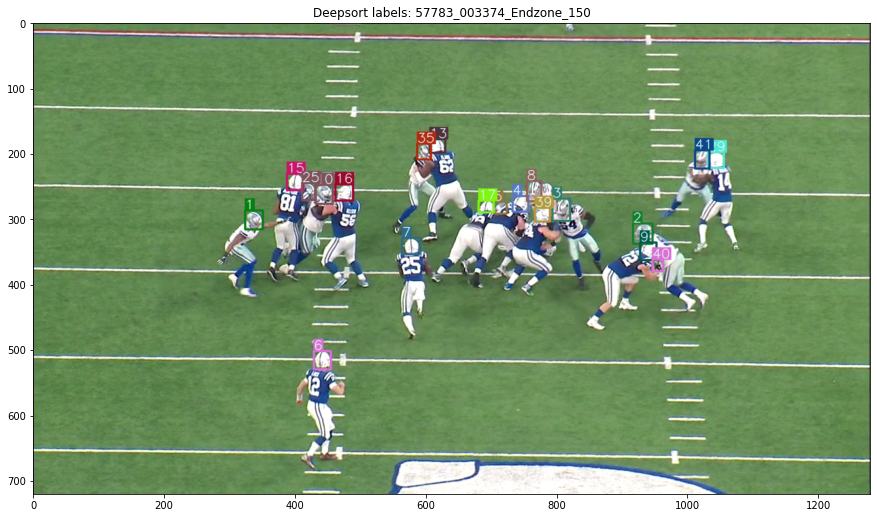

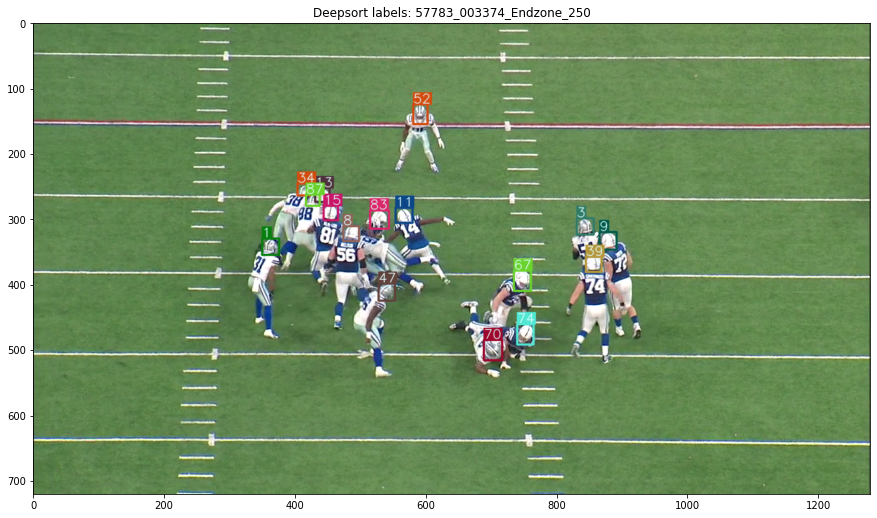

video_data:


,video_frame,left,width,top,height,label,video,frame
18026,57783_003374_Endzone_1,47,25,174,28,V31,57783_003374_Endzone,1
18027,57783_003374_Endzone_1,216,24,328,17,H81,57783_003374_Endzone,1
18028,57783_003374_Endzone_1,242,22,281,30,V98,57783_003374_Endzone,1
18029,57783_003374_Endzone_1,311,24,310,18,H62,57783_003374_Endzone,1
18030,57783_003374_Endzone_1,359,23,130,30,V38,57783_003374_Endzone,1


out:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster
0,57783_003374_Endzone_1,47,25,174,28,V31,57783_003374_Endzone,1,59.0,188.0,NaN,NaN
1,57783_003374_Endzone_1,1049,28,292,31,H14,57783_003374_Endzone,1,1063.0,308.0,NaN,NaN
2,57783_003374_Endzone_1,888,24,145,34,V54,57783_003374_Endzone,1,900.0,162.0,NaN,NaN
3,57783_003374_Endzone_1,814,24,308,20,H73,57783_003374_Endzone,1,826.0,318.0,NaN,NaN
4,57783_003374_Endzone_1,754,23,297,30,H78,57783_003374_Endzone,1,766.0,312.0,NaN,NaN


out with deepsort label:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster,label_deepsort,label_count_deepsort
0,57783_003374_Endzone_1,47,25,174,28,V31,57783_003374_Endzone,1,59.0,188.0,NaN,NaN,NaN,NaN
1,57783_003374_Endzone_1,1049,28,292,31,H14,57783_003374_Endzone,1,1063.0,308.0,NaN,NaN,NaN,NaN
2,57783_003374_Endzone_1,888,24,145,34,V54,57783_003374_Endzone,1,900.0,162.0,NaN,NaN,NaN,NaN
3,57783_003374_Endzone_1,814,24,308,20,H73,57783_003374_Endzone,1,826.0,318.0,NaN,NaN,NaN,NaN
4,57783_003374_Endzone_1,754,23,297,30,H78,57783_003374_Endzone,1,766.0,312.0,NaN,NaN,NaN,NaN


(7840, 13)
(6854, 13)
0.34896 before --> 0.63138 deepsort
==== 57783_003374_Sideline ====


  0%|          | 0/451 [00:00<?, ?it/s]

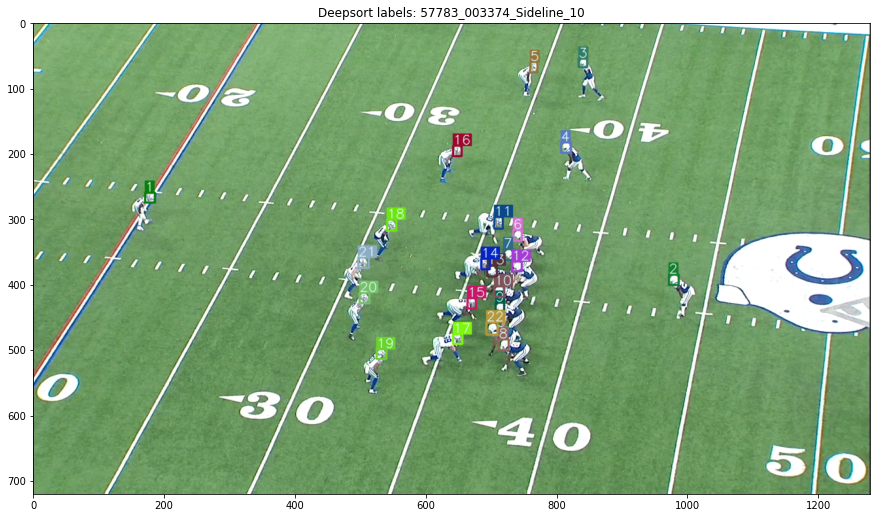

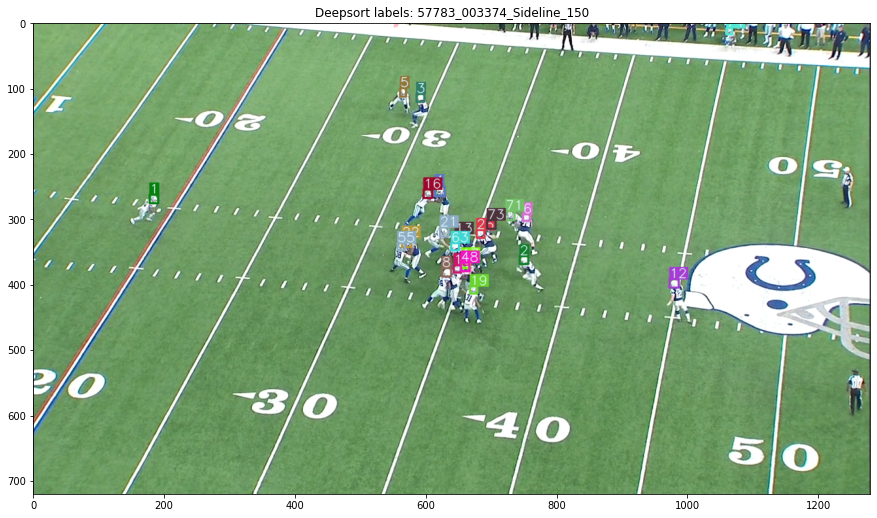

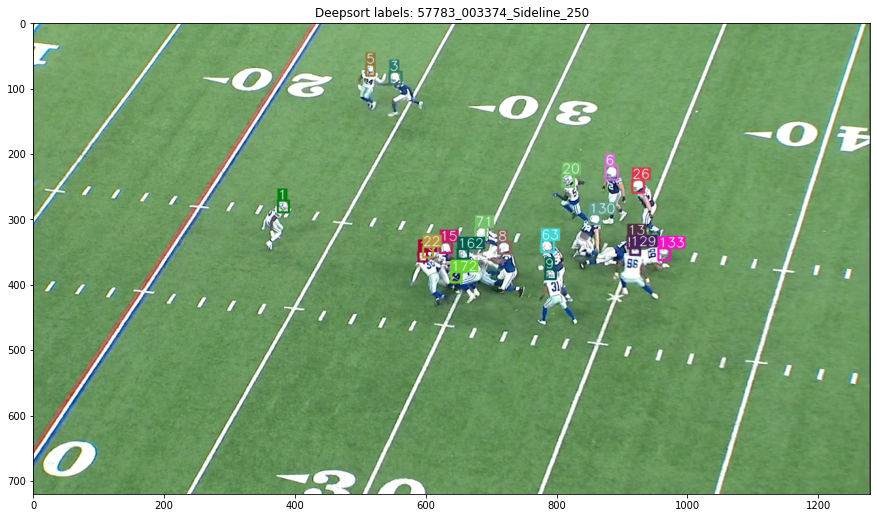

video_data:


,video_frame,left,width,top,height,label,video,frame
25866,57783_003374_Sideline_1,174,14,258,14,V25,57783_003374_Sideline,1
25867,57783_003374_Sideline_1,496,16,359,15,V38,57783_003374_Sideline,1
25868,57783_003374_Sideline_1,498,16,414,16,V55,57783_003374_Sideline,1
25869,57783_003374_Sideline_1,524,16,498,16,V31,57783_003374_Sideline,1
25870,57783_003374_Sideline_1,540,14,301,17,V54,57783_003374_Sideline,1


out:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster
0,57783_003374_Sideline_1,174,14,258,14,V25,57783_003374_Sideline,1,181.0,265.0,NaN,NaN
1,57783_003374_Sideline_1,973,15,386,16,H25,57783_003374_Sideline,1,981.0,394.0,NaN,NaN
2,57783_003374_Sideline_1,836,12,54,14,H15,57783_003374_Sideline,1,842.0,61.0,NaN,NaN
3,57783_003374_Sideline_1,808,14,182,16,H14,57783_003374_Sideline,1,815.0,190.0,NaN,NaN
4,57783_003374_Sideline_1,761,11,59,15,V24,57783_003374_Sideline,1,767.0,67.0,NaN,NaN


out with deepsort label:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster,label_deepsort,label_count_deepsort
0,57783_003374_Sideline_1,174,14,258,14,V25,57783_003374_Sideline,1,181.0,265.0,NaN,NaN,NaN,NaN
1,57783_003374_Sideline_1,973,15,386,16,H25,57783_003374_Sideline,1,981.0,394.0,NaN,NaN,NaN,NaN
2,57783_003374_Sideline_1,836,12,54,14,H15,57783_003374_Sideline,1,842.0,61.0,NaN,NaN,NaN,NaN
3,57783_003374_Sideline_1,808,14,182,16,H14,57783_003374_Sideline,1,815.0,190.0,NaN,NaN,NaN,NaN
4,57783_003374_Sideline_1,761,11,59,15,V24,57783_003374_Sideline,1,767.0,67.0,NaN,NaN,NaN,NaN


(8916, 13)
(7529, 13)
0.32578 before --> 0.34228 deepsort
==== 57997_003691_Endzone ====


  0%|          | 0/354 [00:00<?, ?it/s]

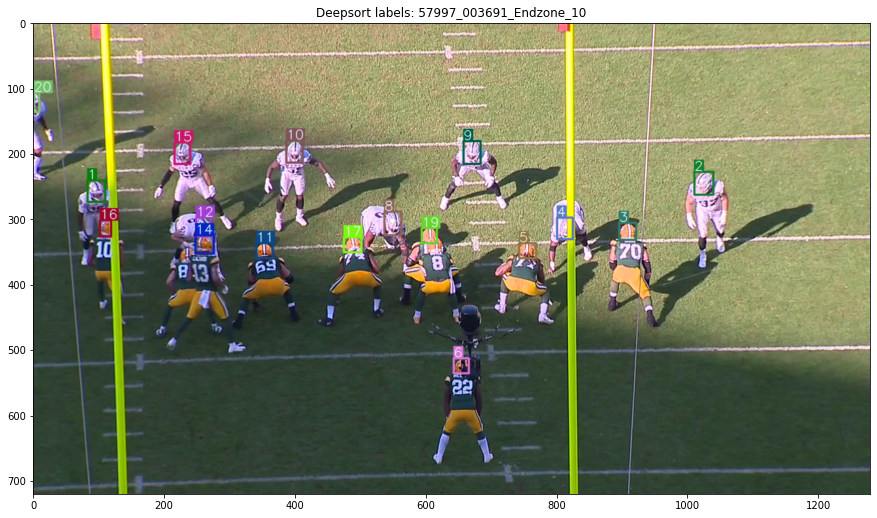

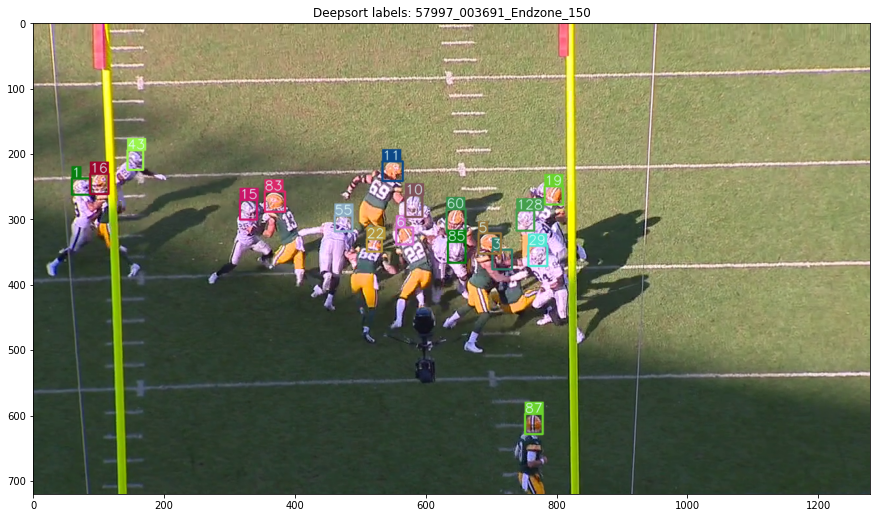

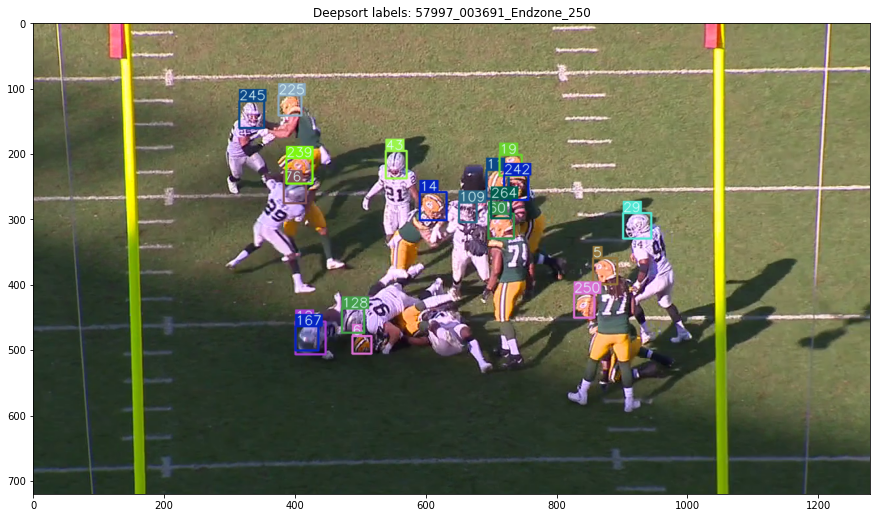

video_data:


,video_frame,left,width,top,height,label,video,frame
34782,57997_003691_Endzone_1,84,26,244,32,V21,57997_003691_Endzone,1
34783,57997_003691_Endzone_1,101,16,302,23,V29,57997_003691_Endzone,1
34784,57997_003691_Endzone_1,211,24,184,34,V25,57997_003691_Endzone,1
34785,57997_003691_Endzone_1,215,26,324,25,H13,57997_003691_Endzone,1
34786,57997_003691_Endzone_1,230,19,346,19,H88,57997_003691_Endzone,1


out:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster
0,57997_003691_Endzone_1,84,26,244,32,V21,57997_003691_Endzone,1,97.0,260.0,NaN,NaN
1,57997_003691_Endzone_1,1012,30,227,35,V20,57997_003691_Endzone,1,1027.0,245.0,NaN,NaN
2,57997_003691_Endzone_1,896,26,306,26,H16,57997_003691_Endzone,1,909.0,319.0,NaN,NaN
3,57997_003691_Endzone_1,801,23,299,32,V97,57997_003691_Endzone,1,813.0,315.0,NaN,NaN
4,57997_003691_Endzone_1,742,26,336,23,V94,57997_003691_Endzone,1,755.0,348.0,NaN,NaN


out with deepsort label:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster,label_deepsort,label_count_deepsort
0,57997_003691_Endzone_1,84,26,244,32,V21,57997_003691_Endzone,1,97.0,260.0,NaN,NaN,NaN,NaN
1,57997_003691_Endzone_1,1012,30,227,35,V20,57997_003691_Endzone,1,1027.0,245.0,NaN,NaN,NaN,NaN
2,57997_003691_Endzone_1,896,26,306,26,H16,57997_003691_Endzone,1,909.0,319.0,NaN,NaN,NaN,NaN
3,57997_003691_Endzone_1,801,23,299,32,V97,57997_003691_Endzone,1,813.0,315.0,NaN,NaN,NaN,NaN
4,57997_003691_Endzone_1,742,26,336,23,V94,57997_003691_Endzone,1,755.0,348.0,NaN,NaN,NaN,NaN


(6659, 13)
(5405, 13)
0.37834 before --> 0.61244 deepsort
==== 57997_003691_Sideline ====


  0%|          | 0/354 [00:00<?, ?it/s]

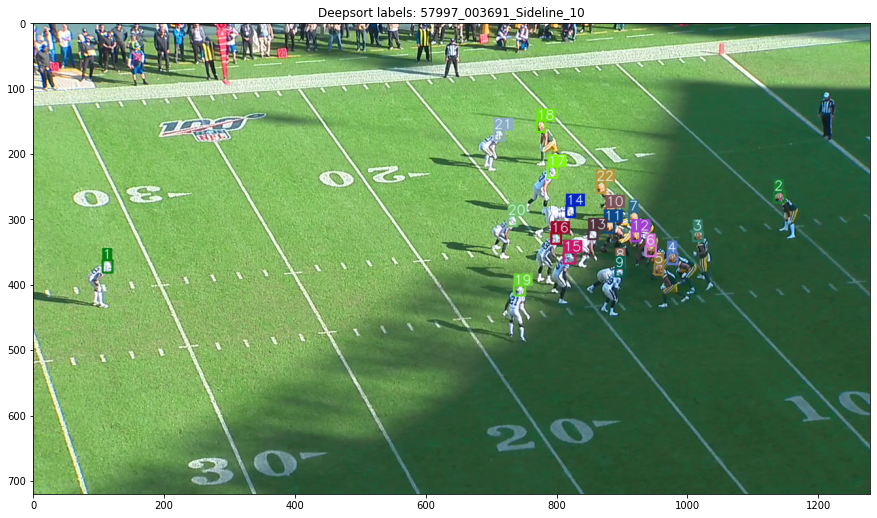

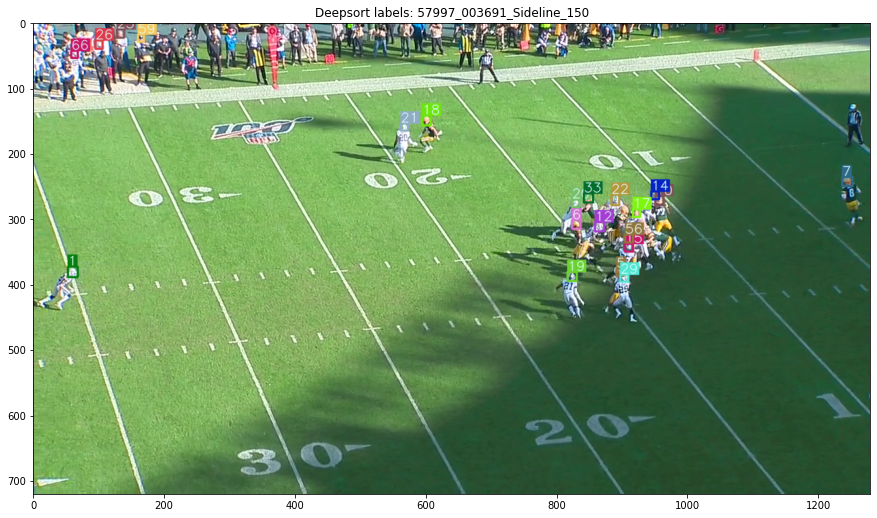

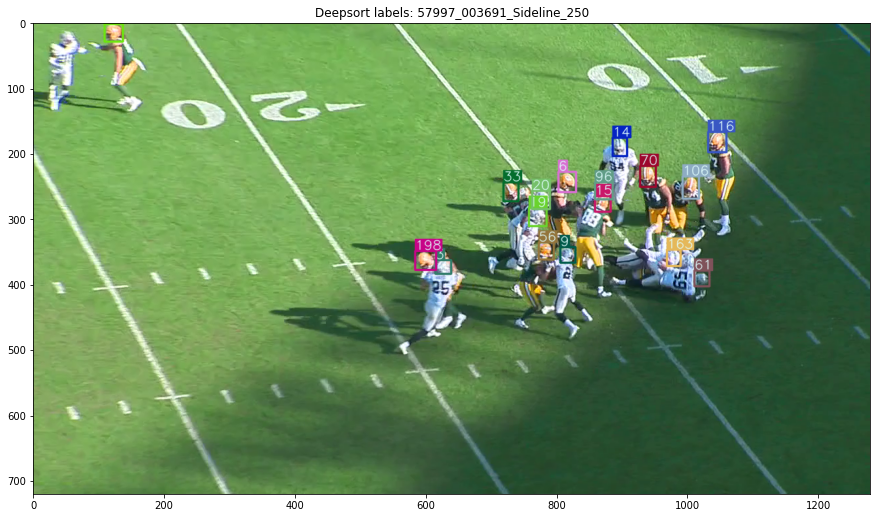

video_data:


,video_frame,left,width,top,height,label,video,frame
41441,57997_003691_Sideline_1,110,14,364,16,V42,57997_003691_Sideline,1
41442,57997_003691_Sideline_1,705,14,164,15,V20,57997_003691_Sideline,1
41443,57997_003691_Sideline_1,726,14,294,16,V50,57997_003691_Sideline,1
41444,57997_003691_Sideline_1,742,16,406,14,V21,57997_003691_Sideline,1
41445,57997_003691_Sideline_1,770,14,150,16,H16,57997_003691_Sideline,1


out:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster
0,57997_003691_Sideline_1,110,14,364,16,V42,57997_003691_Sideline,1,117.0,372.0,NaN,NaN
1,57997_003691_Sideline_1,1133,16,258,17,H22,57997_003691_Sideline,1,1141.0,266.0,NaN,NaN
2,57997_003691_Sideline_1,1015,16,323,17,H13,57997_003691_Sideline,1,1023.0,331.0,NaN,NaN
3,57997_003691_Sideline_1,970,14,352,17,H88,57997_003691_Sideline,1,977.0,360.0,NaN,NaN
4,57997_003691_Sideline_1,951,13,368,16,H10,57997_003691_Sideline,1,957.0,376.0,NaN,NaN


out with deepsort label:


,video_frame,left,width,top,height,label,video,frame,x,y,top_deepsort,deepsort_cluster,label_deepsort,label_count_deepsort
0,57997_003691_Sideline_1,110,14,364,16,V42,57997_003691_Sideline,1,117.0,372.0,NaN,NaN,NaN,NaN
1,57997_003691_Sideline_1,1133,16,258,17,H22,57997_003691_Sideline,1,1141.0,266.0,NaN,NaN,NaN,NaN
2,57997_003691_Sideline_1,1015,16,323,17,H13,57997_003691_Sideline,1,1023.0,331.0,NaN,NaN,NaN,NaN
3,57997_003691_Sideline_1,970,14,352,17,H88,57997_003691_Sideline,1,977.0,360.0,NaN,NaN,NaN,NaN
4,57997_003691_Sideline_1,951,13,368,16,H10,57997_003691_Sideline,1,957.0,376.0,NaN,NaN,NaN,NaN


(7335, 13)
(5059, 13)
0.19950 before --> 0.26074 deepsort


In [9]:
outs = []
for myvideo, video_data in tqdm(submission_df.groupby('video'), 
                                total=submission_df['video'].nunique()):
    
    print(f'==== {myvideo} ====')
    video_pth = f'{video_dir}/{myvideo}.mp4'
    
    if debug:
        out = deepsort_helmets(video_data, video_pth, plot_frames=[10, 150, 250])
    else:
        out = deepsort_helmets(video_data, video_pth)
    
    # peek
    print('video_data:')
    display(video_data.head())
    print('out:')
    display(out.head())

    out = add_deepsort_label_col(out)
    
    # peek
    print('out with deepsort label:')
    display(out.head())
    
    outs.append(out)
    
    if debug:
        score_vs_deepsort(myvideo, out, labels)
        
submission_deepsort = pd.concat(outs).copy()

# Check submission & save

In [10]:
ss = pd.read_csv('../input/nfl-health-and-safety-helmet-assignment/sample_submission.csv')

submission_deepsort['label_deepsort'].fillna(submission_deepsort['label'], inplace=True)
submission_deepsort.drop('label', axis=1, inplace=True)
submission_deepsort.rename(columns={'label_deepsort': 'label'}, inplace=True)
submission_deepsort = submission_deepsort[ss.columns]
is_duped = submission_deepsort[['video_frame', 'label']].duplicated()
submission_deepsort = submission_deepsort[~is_duped]

check_submission(submission_deepsort)

p = '/kaggle/working/' + 'submission_helmtrack2d_deepsort_debug.csv'
submission_deepsort.to_csv(p, index=False)

# Display video showing predictions

In [11]:
if debug:
    submission_deepsort['video'] = (
        submission_deepsort['video_frame']
        .str.split('_')
        .str[:3]
        .str.join('_') + '.mp4'
    )
    
    debug_videos = submission_deepsort['video'].unique()
    debug_labels = labels.query('video in @debug_videos')
    
    scorer = NFLAssignmentScorer(debug_labels)
    scorer.score(submission_deepsort)
    
    video_out = video_with_predictions(f'{video_dir}/{debug_videos[0]}',
                                       scorer.sub_labels)
    
    frac = 0.6
    display(
        Video(data=video_out, embed=True, 
              height=int(frac * 720), width=int(frac * 1280))
    )
    

Running for 57700_001264_Endzone
